In [1]:
import pandas as pd
import geopandas as gpd
import plotly.express as px

In [56]:
info_dataset_path = '../1000_cleaning/output/1310_crime_population_dataset.csv'
map_dataset_path = '../1000_cleaning/output/1400_map_dataset.geojson'
combined_dataset_path = 'output/2100_combined_dataset.geojson'

In [3]:
info_dataset = pd.read_csv(info_dataset_path)
info_dataset.head()

,County,Occurrences,Population
0,Cavan,51026.0,76176.0
1,Clare,78677.0,118817.0
2,Cork,418178.0,542868.0
3,Donegal,114465.0,159192.0
4,Dublin,1862658.0,1347359.0


In [4]:
map_dataset = gpd.read_file(map_dataset_path)
map_dataset.head()

,County,geometry
0,Carlow,"POLYGON ((-6.59242 52.70810, -6.59292 52.70730..."
1,Cavan,"POLYGON ((-7.27517 53.78388, -7.27538 53.78377..."
2,Clare,"MULTIPOLYGON (((-9.04528 52.71819, -9.04528 52..."
3,Cork,"MULTIPOLYGON (((-10.16361 51.57986, -10.16528 ..."
4,Donegal,"MULTIPOLYGON (((-7.24083 55.44958, -7.24078 55..."


In [5]:
dataset = gpd.GeoDataFrame(info_dataset.set_index('County').join(map_dataset.set_index('County'),how='inner').reset_index(names=['County']))
dataset.head()

,County,Occurrences,Population,geometry
0,Cavan,51026.0,76176.0,"POLYGON ((-7.27517 53.78388, -7.27538 53.78377..."
1,Clare,78677.0,118817.0,"MULTIPOLYGON (((-9.04528 52.71819, -9.04528 52..."
2,Cork,418178.0,542868.0,"MULTIPOLYGON (((-10.16361 51.57986, -10.16528 ..."
3,Donegal,114465.0,159192.0,"MULTIPOLYGON (((-7.24083 55.44958, -7.24078 55..."
4,Dublin,1862658.0,1347359.0,"MULTIPOLYGON (((-6.04858 53.37128, -6.04919 53..."


<Axes: >

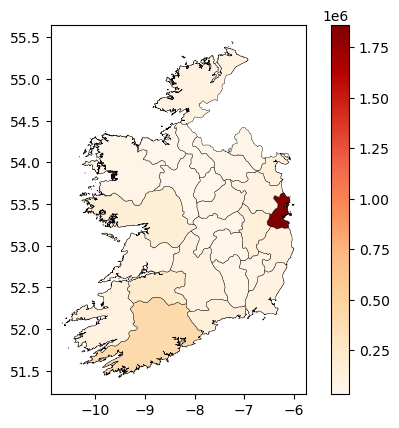

In [6]:
dataset.plot(column='Occurrences',cmap='OrRd', edgecolor='k', linewidth=0.3,legend=True)

In [259]:
dataset.to_file('output/2100_combined_dataset.geojson', driver='GeoJSON',index=False)
print("Saved combined dataset")

Saved combined dataset


In [16]:
dataset['Occurrences by population'] = dataset['Occurrences']/dataset['Population']
dataset.head()

,County,Occurrences,Population,geometry,Occurrences by population
0,Cavan,51026.0,76176.0,"POLYGON ((-7.27517 53.78388, -7.27538 53.78377...",0.669844
1,Clare,78677.0,118817.0,"MULTIPOLYGON (((-9.04528 52.71819, -9.04528 52...",0.662170
2,Cork,418178.0,542868.0,"MULTIPOLYGON (((-10.16361 51.57986, -10.16528 ...",0.770312
3,Donegal,114465.0,159192.0,"MULTIPOLYGON (((-7.24083 55.44958, -7.24078 55...",0.719037
4,Dublin,1862658.0,1347359.0,"MULTIPOLYGON (((-6.04858 53.37128, -6.04919 53...",1.382451


<Axes: >

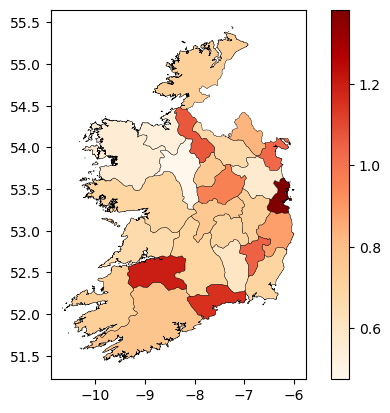

In [274]:
dataset.plot(column='Occurrences by population',cmap='OrRd', edgecolor='k', linewidth=0.3,legend=True)

In [276]:
dataset.to_file('output/2100_normalized_dataset.geojson', driver='GeoJSON',index=False)
print("Saved normalized dataset")

Saved normalized dataset


In [20]:
import plotly.graph_objects as go

In [52]:
dataset=dataset.set_index('County')

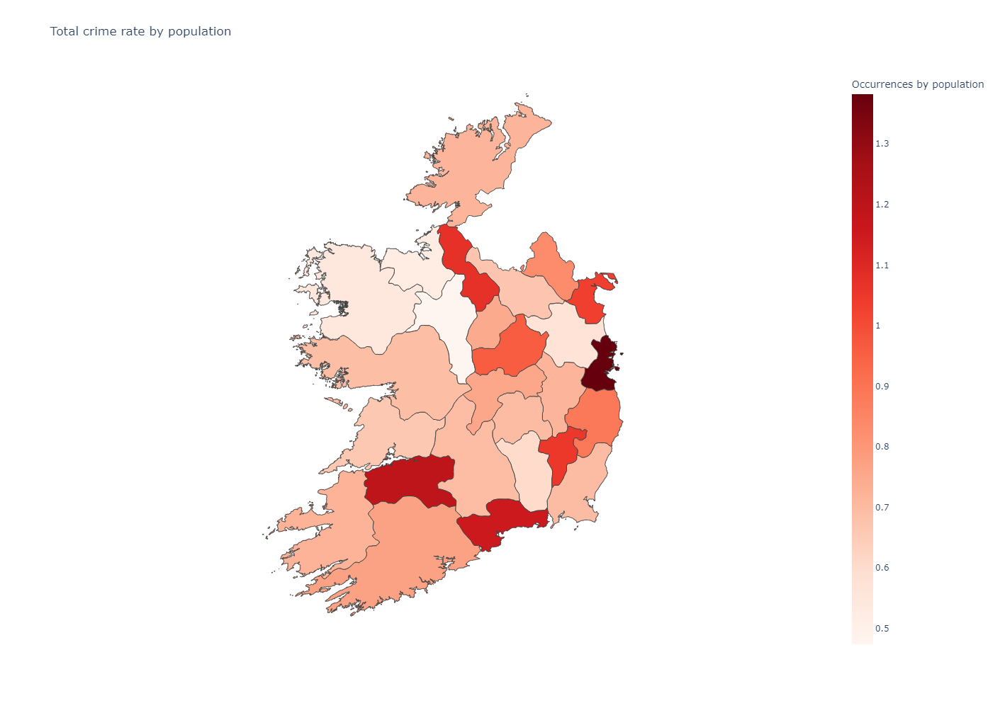

In [55]:
fig = px.choropleth(dataset,
                        geojson=dataset.geometry,
                        locations=dataset.index,
                        color="Occurrences by population",
                        color_continuous_scale='Reds',
                        projection="mercator",
                        title='Total crime rate by population',
                        width=1000,
                        height=1000,
                        hover_data=['Population']
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.show()